In [2]:
# load all of the csv files into a list

import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt


In [3]:
def read_all_csv(label):
    # reads all csv files in the directory and put them in one df
    dictionary = {}
    for dir in os.listdir(label):
        if dir.endswith(".csv") and dir != "all_neg.csv" and dir.startswith("38"): ##################
            df_temp = pd.read_csv(os.path.join(label, dir))
            dictionary[dir] = df_temp
    return dictionary


In [4]:
def vis_enrichment(seq):
    num_rows = len(seq)
    # print(num_rows)
    # create a dictionary with the nucleotides
    nucleotides = {"A": 0, "T": 0, "C": 0, "G": 0,}
    # create a dictionary with the nucleotides and their percentages
    nucleotides_perc = {"A": 0, "T": 0, "C": 0, "G": 0}
    for nuc in seq:
        if nuc not in nucleotides.keys():
            nucleotides["A"] += 1
        else:
            nucleotides[nuc] += 1
    nucleotides_perc["A"] = nucleotides["A"] / num_rows
    nucleotides_perc["T"] = nucleotides["T"] / num_rows
    nucleotides_perc["C"] = nucleotides["C"] / num_rows
    nucleotides_perc["G"] = nucleotides["G"] / num_rows

    return [nucleotides_perc["A"], nucleotides_perc["T"], nucleotides_perc["C"], nucleotides_perc["G"]]


In [49]:
pos = {} 
pos['pos_100bp.csv'] = pd.read_csv("positive/all_pos.csv")

pos['pos_100bp.csv']['strand'] = pos['pos_100bp.csv']['header'].apply(lambda x: "+" if "+" in x else "-" )
print(pos['pos_100bp.csv']['strand'].unique())

['+' '-']


In [50]:

pos['pos_100bp.csv'] = pos['pos_100bp.csv'][pos['pos_100bp.csv']['strand'] == '-']

neg = {}
neg['pos_100bp_neg.csv'] = pd.read_csv("10x_neg_overlapping_20percent/all_neg.csv", )
# frac 0.1 neg 
neg['pos_100bp_neg.csv'] = neg['pos_100bp_neg.csv'].sample(frac=0.05, random_state=1)


In [133]:
pos = {}
pos["edited-MethanococcusMaripaludis_S2_NC005791.1_100bp.csv"] = pd.read_csv("/home/amin/Desktop/TermFinder/Data/Other/archea_PMC8716108/edited-MethanococcusMaripaludis_S2_NC005791.1_100bp.csv")
neg = {}
neg["edited-MethanococcusMaripaludis_S2_NC005791.1_100bp_neg.csv"] = pd.read_csv("/home/amin/Desktop/TermFinder/Data/Other/archea_PMC8716108/edited-MethanococcusMaripaludis_S2_NC005791.1_100bp_neg.csv")

In [8]:
# pos = read_all_csv("../")
# neg = read_all_csv("../38_tuberculosis/neg.fasta")

# # delete item with key all_neg.csv
# del pos["all_pos.csv"]
# del neg["all_neg.csv"]

In [135]:
a = pos["edited-MethanococcusMaripaludis_S2_NC005791.1_100bp.csv"].sequence.apply(lambda x: len(x)).min()

# select the first 100 chars from sequence so every one is the same length
pos["edited-MethanococcusMaripaludis_S2_NC005791.1_100bp.csv"].sequence = pos["edited-MethanococcusMaripaludis_S2_NC005791.1_100bp.csv"].sequence.apply(lambda x: x[:a])


In [136]:
neg["edited-MethanococcusMaripaludis_S2_NC005791.1_100bp_neg.csv"].sequence = neg["edited-MethanococcusMaripaludis_S2_NC005791.1_100bp_neg.csv"].sequence.apply(lambda x: x[:a])

In [126]:
pos["Archea_Haloferax_volcanii_DS2_NC013967.1_100bp.csv"]['dir'] = "archea_PMC7237163"
neg["Archea_Haloferax_volcanii_DS2_NC013967.1_100bp_neg.csv"]['dir'] = "archea_PMC7237163"


In [127]:
# pos["Archea_Haloferax_volcanii_DS2_NC013967.1_100bp.csv"] = pos["Archea_Haloferax_volcanii_DS2_NC013967.1_100bp.csv"][pos["Archea_Haloferax_volcanii_DS2_NC013967.1_100bp.csv"].header.str.split("(", expand=True)[1] == "-)"]

In [52]:
neg["pos_100bp_neg.csv"].sequence.apply(lambda x: len(x)).describe()

count    21231.0
mean       101.0
std          0.0
min        101.0
25%        101.0
50%        101.0
75%        101.0
max        101.0
Name: sequence, dtype: float64

In [51]:
# drop the one with the min len

neg['pos_100bp_neg.csv'] = neg['pos_100bp_neg.csv'][neg['pos_100bp_neg.csv']['sequence'].str.len() > 100]

In [129]:
# pos['37_PMC3219970_SynechococcusElongatus_PCC7942_CP000100.1_100bp.csv']['sequence']
# neg['37_PMC3219970_SynechococcusElongatus_PCC7942_CP000100.1_100bp_10x_neg.csv'] = neg['37_PMC3219970_SynechococcusElongatus_PCC7942_CP000100.1_100bp_10x_neg.csv'].iloc[0:1451]
# neg

In [47]:
# pair the keys of two dictionaries side by side
for key in pos.keys():
    if type(neg[key.replace('_100bp.csv', '_100bp_neg.csv')]) == pd.core.frame.DataFrame:
        print(key, pos[key].shape, neg[key.replace('_100bp.csv', '_100bp_neg.csv')].shape, sep='\t')



pos_100bp.csv	(20464, 6)	(21231, 5)


In [131]:
# # pair the keys of two dictionaries side by side
# for key in pos.keys():
#     if type(neg[key.replace('_100bp.csv', '_100bp_10x_neg.csv')]) == pd.core.frame.DataFrame:
#         print(key, pos[key].shape, neg[key.replace('_100bp.csv', '_100bp_10x_neg.csv')].shape, sep='\t')



pos_100bp.csv
pos_100bp.csv
<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>

[['C', 'A', 'A', 'T', 'A', 'A', 'C', 'C', 'A', 'C', 'T', 'C', 'T', 'C', 'G', 'T', 'T', 'G', 'A', 'G', 'A', 'T', 'A', 'A', 'A', 'T', 'A', 'A', 'T', 'A', 'A', 'A', 'C', 'C', 'T', 'C', 'T', 'G', 'C', 'A', 'G', 'A', 'G', 'C', 'A', 'G', 'A', 'G', 'G', 'T', 'T', 'T', 'A', 'T', 'T', 'T', 'T', 'A', 'A', 'A', 'A', 'T', 'T', 'T', 'A', 'C', 'G', 'G', 'A', 'T', 'T', 'G', 'G', 'A', 'T', 'C', 'G', 'C', 'T', 'C', 'G', 'T', 'A', 'T', 'A', 'T', 'C', 'C', 'T', 'G', 'C', 'T', 'C', 'T', 'A', 'G', 'C', 'A', 'C', 'C', 'G'], ['T', 'C', 'T', 'A', 'T', 'T', 'T', 'A', 'A', 'T', 'A', 'A', 'A', 'A', 'A', 'G', 'T', 'C', 'A', 'T', 'A', 'T', 'A', 'A', 'T', 'C', 'C', 'A', 'A', 'A', 'A', 'A', 'A', 'A', 'G', 'C', 'T', 'C', 'A', 'C', 'C', 'A', 'T', 'A', 'A', 'G', 'T', 'G', 'A', 'G', 'C', 'T', 'T', 'T', 'T', 'A', 'A', 'C', 'T', 'A', 'T', 'T', 'A', 'T', 'C', 'T', 'G', 'T', 'T', 'T', 'T', 'A', 'T', 'G', 'T', 'T', 'A', 'A', 

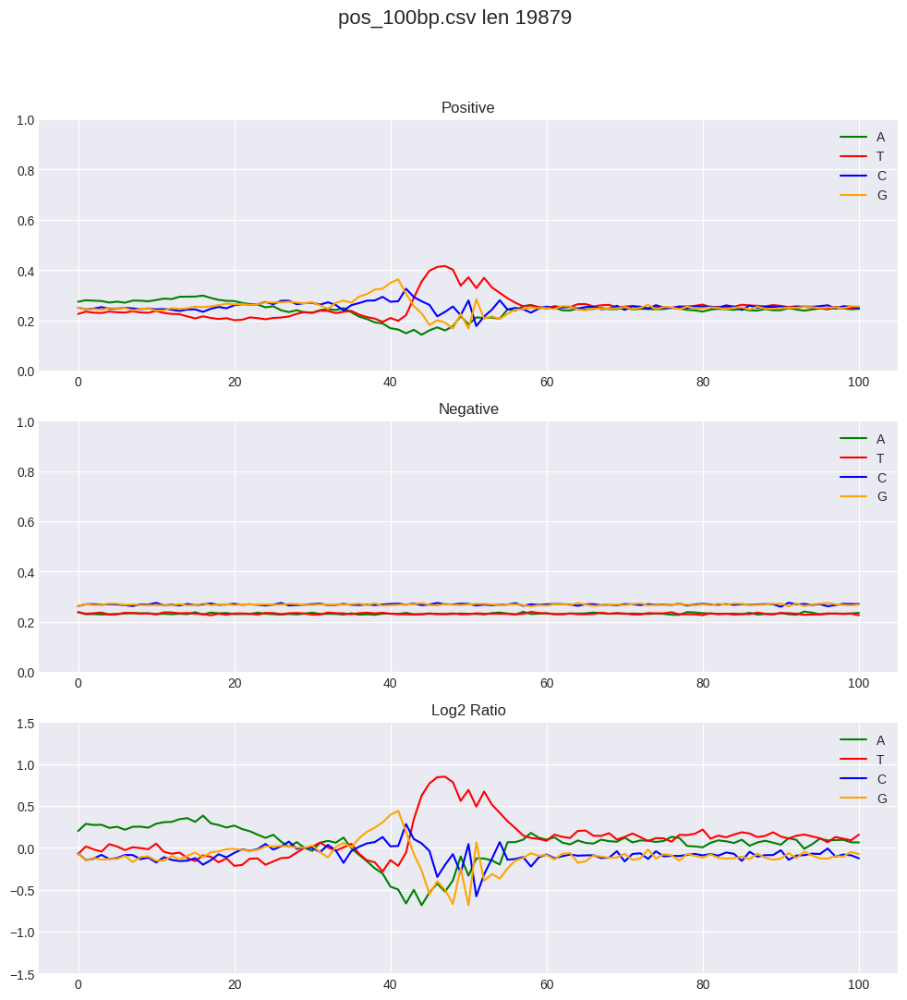

In [53]:
import matplotlib as mpl
mpl.style.use('seaborn-darkgrid')
mpl.rcParams['figure.dpi'] = 100

for key in pos.keys():
    if "100bp.csv" in key:
        key = key
        print(key)
        key_neg = key.replace('_100bp.csv', '_100bp_neg.csv')
        # key = '37_PMC3219970_SynechococcusElongatus_PCC7942_CP000100.1_100bp.csv'
        # key_neg = '37_PMC3219970_SynechococcusElongatus_PCC7942_CP000100.1_100bp_10x_neg.csv'
        
        df_A = pos[key]['sequence'] # Positive
        df_A_neg = neg[key_neg]['sequence'] # Negative

        title_A = key
        title_A_neg = key_neg
        
        print(title_A)

        print(type(df_A))
        print(type(df_A_neg))

        print()
        ss = [list(s) for s in df_A]
        jj = [list(j) for j in df_A_neg]

        print((ss))
        print((jj))

        # make it numpy array for every character in the string for every row
        ar_A =     np.array(ss, )
        ar_A_neg = np.array(jj, )

        df_A = pd.DataFrame(ar_A)
        df_A_neg = pd.DataFrame(ar_A_neg)

        
        df_A_vis = df_A.apply(vis_enrichment)
        df_A_neg_vis = df_A_neg.apply(vis_enrichment)

        s = np.log2(df_A_vis / df_A_neg_vis)

        # subplot 3 * 1 
        fig, ax = plt.subplots(3, 1, figsize=(12, 12), )

        # title for the whole figure
        fig.suptitle(title_A + ' len ' + str(len(df_A)), fontsize=16)

        color_dict = {'G':'orange', 'C':'blue', 'T':'red', 'A':'green'}
        df_A_vis.T.rename(columns={0: 'A', 1: 'T', 2: 'C', 3: 'G'}).plot(kind='line', ylim=[0,1], title="Positive", ax=ax[0], color=color_dict )
        df_A_neg_vis.T.rename(columns={0: 'A', 1: 'T', 2: 'C', 3: 'G'}).plot(kind='line', ylim=[0,1], title="Negative", ax=ax[1], color=color_dict )
        s.T.rename(columns={0: 'A', 1: 'T', 2: 'C', 3: 'G'}).plot(kind='line', ylim=[-1.5,1.5], title='Log2 Ratio', ax=ax[2], color=color_dict )

        # save the figure
        fig.savefig(f'vis_new/{title_A}.png')
        

In [22]:
def read_all_csv_neg():
    # reads all csv files in the directory and put them in one df
    dictionary = {}
    for dir in os.listdir(path='./5x_neg'):
        if dir.endswith(".csv"):
            df_temp = pd.read_csv('./5x_neg/' + dir)
            dictionary[dir] = df_temp
    return dictionary

d_neg = read_all_csv_neg()


In [17]:
super_list_of_desc = []
for key in d.keys():
    if "100bp.csv" in key:
        key = key
        key_neg = key.replace('_100bp.csv', '_100bp_5x_neg.csv')

        df_A = d[key]['sequence'] # Positive
        df_A_neg = d_neg[key_neg]['sequence'] # Negative
        
        print(key_neg)

        list_of_desc = []

        for i in range(0,len(df_A_neg)-len(df_A), len(df_A)):
            # chop the df_A_neg into 5 chunks
            df_A_neg_chunk = df_A_neg[i:i+len(df_A)]
            df_A = d[key]['sequence'] # Positive

            # make it numpy array for every character in the string for every row
            ar_A = np.array([list(x) for x in df_A])
            ar_A_neg = np.array([list(x) for x in df_A_neg_chunk])

            df_A = pd.DataFrame(ar_A)
            df_A_neg_chunk = pd.DataFrame(ar_A_neg)

            df_A_vis = df_A.apply(vis_enrichment)
            df_A_neg_vis = df_A_neg_chunk.apply(vis_enrichment)
            # print((df_A_neg_vis).shape)
            s = np.log2(df_A_vis / df_A_neg_vis)
            # print(s.T.describe().loc['mean'])
            # print(s.T.describe().loc['std'])
            list_of_desc.append(s.T.describe())

            # print ("###################################")
        # average for all descriptions
        df_desc = pd.concat(list_of_desc)
        df_desc = df_desc.groupby(df_desc.index).mean()
        # print(df_desc)
        super_list_of_desc.append(df_desc)
        
df_desc = pd.concat(super_list_of_desc)
df_desc = df_desc.groupby(df_desc.index).mean()
print(df_desc)

NameError: name 'd' is not defined

In [ ]:
               0          1          2          3
25%    -0.178383  -0.137376  -0.325216  -0.316711
50%     0.052886   0.073939  -0.091251        NaN
75%     0.286033   0.305584   0.083570   0.089682
count  98.168478  98.043478  97.342391  97.326087
max     0.778317   1.232686   0.653198   0.666626
mean    0.004934   0.093856  -0.133919  -0.141963
min    -1.475627  -1.068483  -1.239326  -1.586914
std     0.411964   0.412882   0.288973   0.331101

In [106]:
GC content of E. coli K12 chromosome.
Value	50.8 %

Bacillus subtilis is
low GC content (43%) 

 S. avermitilis contains 9,025,608 bases with
 70.7 % average GC content and 

Streptomyces griseus
median GC%: 72.2

S. Lividans
 median GC%: 72.2

Synechocystis
median GC%: 47.6075

Vibrio parahaemolyticus
 median GC%: 45.3

Streptomyces clavuligerus
 median GC%: 72.5

Zymomonas mobilis
 median GC%: 46.1

Streptomyces coelicolor
 median GC%: 72.2

Streptomyces tsukubensis
 median GC%: 71.891

Streptomyces venezuelae
 median GC%: 72.3

Pseudomonas aeruginosa
 median GC%: 66.2

Staphylococcus aureus
 median GC%: 32.7

Streptococcus pneumoniae
 median GC%: 39.6

Caulobacter vibrioides
 median GC%: 67.2

CaulobacterCrescentus_# vibrioides
 median GC%: 67.2

VibrioNatriegens
 median GC%: 45

Dickeya dadantii
 median GC%: 56.4027

Clostridioides difficile
 median GC%: 28.5

Salmonella enterica
 median GC%: 52.1

Streptococcus agalactiae
 median GC%: 35.4

Photobacterium profundum
 median GC%: 41.4

Synechococcus elongatus
 median GC%: 55.428


SyntaxError: invalid syntax (1989053897.py, line 1)